In [1]:
#General packages
from IPython.display import clear_output #import of a single funtcion
import sys #system related packages
import os #better path and file handling

#Tables, numbers etc
import pandas as pd #tables
import numpy as np #arrays
import scipy #sciency functions
from sklearn import mixture #For gaussian mixture model

import scanpy as sc #Main package for scRNA-seq analysis
import seaborn as sns

In [2]:
#Print package versions for important packages (matplotlib and seaborn are excluded from this list)
sc.logging.print_header()
sc.set_figure_params(dpi=400, fontsize=8)

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.21.5 scipy==1.8.0 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.1 python-igraph==0.9.9 louvain==0.7.1 pynndescent==0.5.6


In [3]:
path = '/Users/zhuliu/Desktop/scRNA_STseq/proj_10X_woundhealing/03_results/01-Seurat-PreAnalysis/02_Seurat_BatchCorrection/s2_Seurat_subKeratinocytes/pySCENIC'
adata = sc.read(os.path.join(path, 'allNew_scanpy_subkeratins.h5ad'))

In [4]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [5]:
sc.pl.umap(adata, color = ['CellTypes','Phase', 'KRT5', 'KRT10', "KRT16", "KRT17", "KRT6A", "KRT6B", 
                           "KRT6C", "MKI67", "MMP1", "MMP3"],
           cmap=sns.blend_palette(["lightgray", sns.xkcd_rgb["red"]], as_cmap=True),
           ncols=4)

In [6]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=40, use_rep='X_harmony')
#sc.tl.leiden(adata, resolution=0.8)
#sc.pl.umap(adata, color=['leiden', 'CellTypes'])

In [7]:
adata.raw=adata

# KRT6A

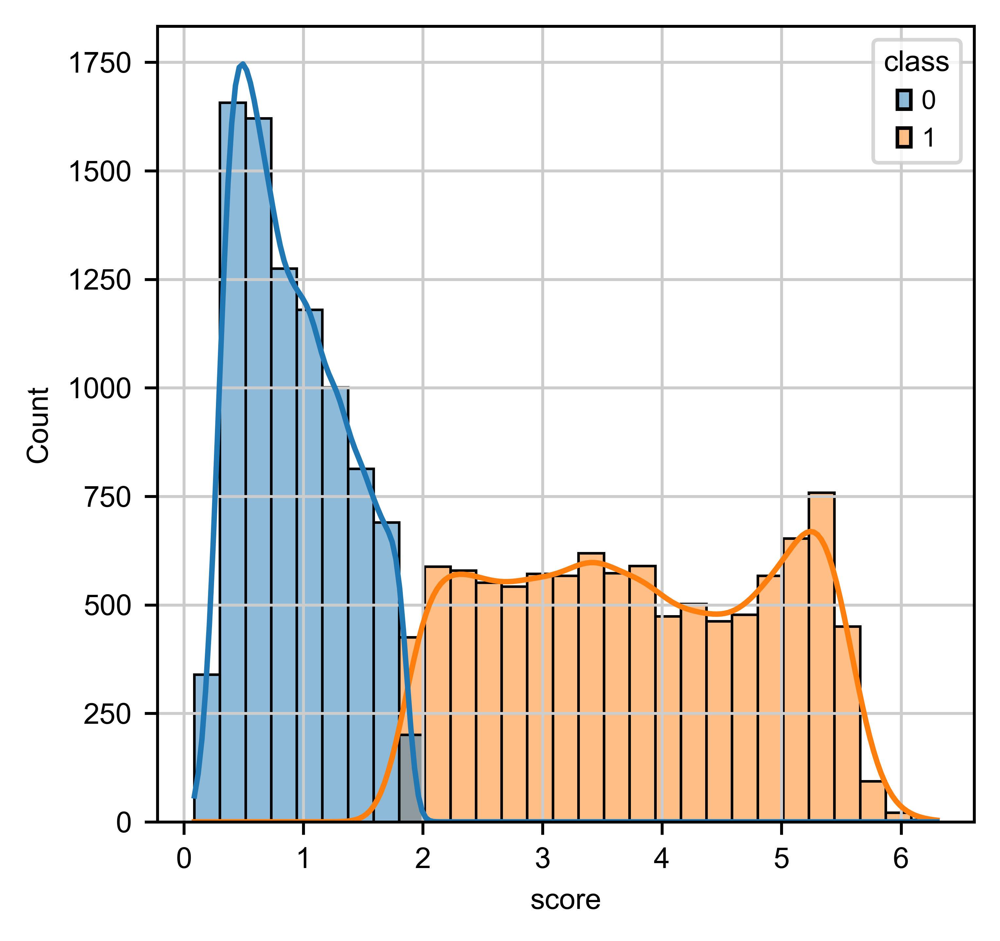

In [37]:
gene = 'KRT6A' # Which gene to use

x = adata.raw[:, gene].X.toarray() # Get raw expression matrix
pos_cells = adata.obs_names[x.flatten()>0] #Don't include cells with 0-epxression in the gaussian mixture classification (they interfere a bit with the results)
x = adata.raw[pos_cells][:, gene].X.toarray() #Get raw expression matrix again, but keep only positive cells

components = 2 #How many classes do we want
gmm = mixture.GaussianMixture(n_components=components, covariance_type='full').fit(x) #Initialize and fit gaussian mixture model based on expression levels

tmp = pd.DataFrame(x, columns = ['score'], index = pos_cells) #Temporary dataframe to keep expression and annotated classes
tmp['class'] = gmm.predict(x) #Predict cell class based on gene expression
sort = {x: ix for ix, (x, s) in enumerate(tmp.groupby('class')['score'].mean().sort_values().items())} #Sort the class so that the lowest class is always negative (normally it starts to number classes based on which class has most events)
tmp['class'] = [sort[x] for x in tmp['class']] #Do actual sorting

sns.histplot(tmp, x = 'score', hue = 'class', palette = 'tab10', kde = True) #Plot results as histogram

adata.obs['{}_class'.format(gene)] = ['{}-'.format(gene) if x not in tmp.index else '{} dim'.format(gene) if tmp.loc[x, 'class']==0 else '{}+'.format(gene) for x in adata.obs_names] 

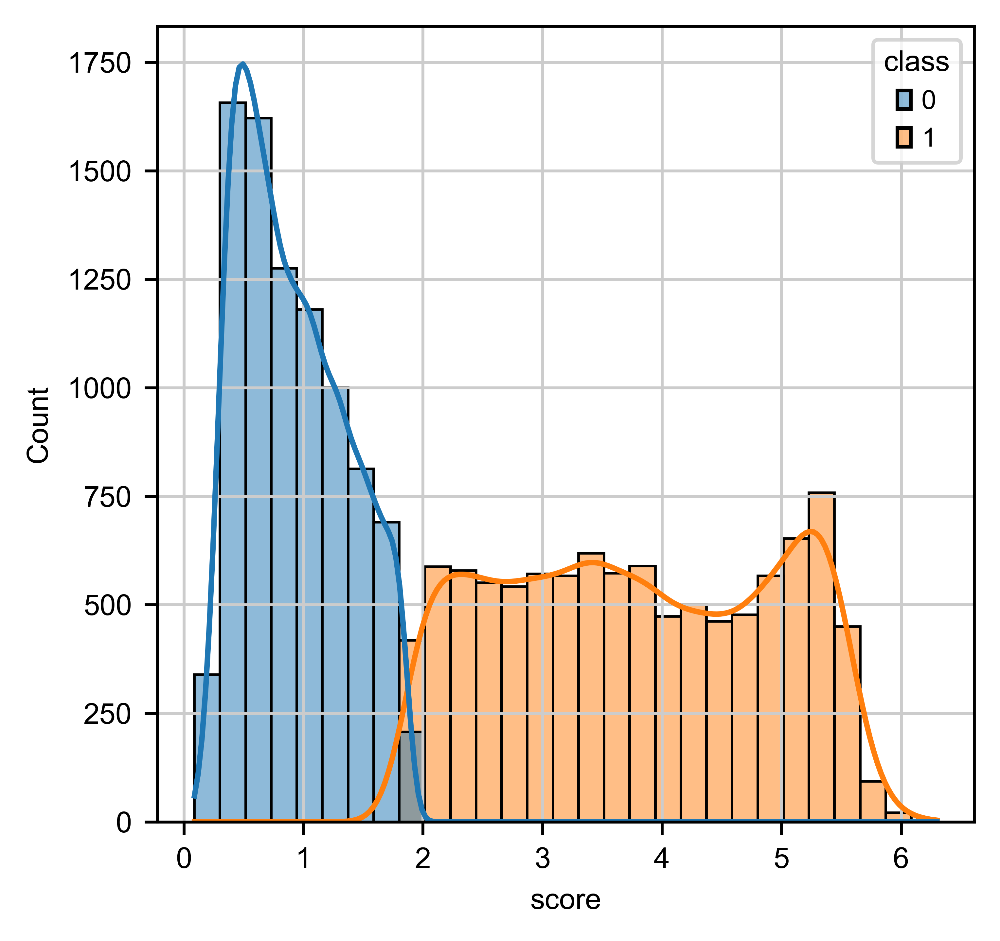

In [8]:
gene = 'KRT6A' # Which gene to use

x = adata.raw[:, gene].X.toarray() # Get raw expression matrix
pos_cells = adata.obs_names[x.flatten()>0] #Don't include cells with 0-epxression in the gaussian mixture classification (they interfere a bit with the results)
x = adata.raw[pos_cells][:, gene].X.toarray() #Get raw expression matrix again, but keep only positive cells

components = 2 #How many classes do we want
gmm = mixture.GaussianMixture(n_components=components, covariance_type='full').fit(x) #Initialize and fit gaussian mixture model based on expression levels

tmp = pd.DataFrame(x, columns = ['score'], index = pos_cells) #Temporary dataframe to keep expression and annotated classes
tmp['class'] = gmm.predict(x) #Predict cell class based on gene expression
sort = {x: ix for ix, (x, s) in enumerate(tmp.groupby('class')['score'].mean().sort_values().items())} #Sort the class so that the lowest class is always negative (normally it starts to number classes based on which class has most events)
tmp['class'] = [sort[x] for x in tmp['class']] #Do actual sorting

sns.histplot(tmp, x = 'score', hue = 'class', palette = 'tab10', kde = True) #Plot results as histogram

adata.obs['{}_class'.format(gene)] = ['{}-'.format(gene) if x not in tmp.index else '{} dim'.format(gene) if tmp.loc[x, 'class']==0 else '{}+'.format(gene) for x in adata.obs_names] 

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


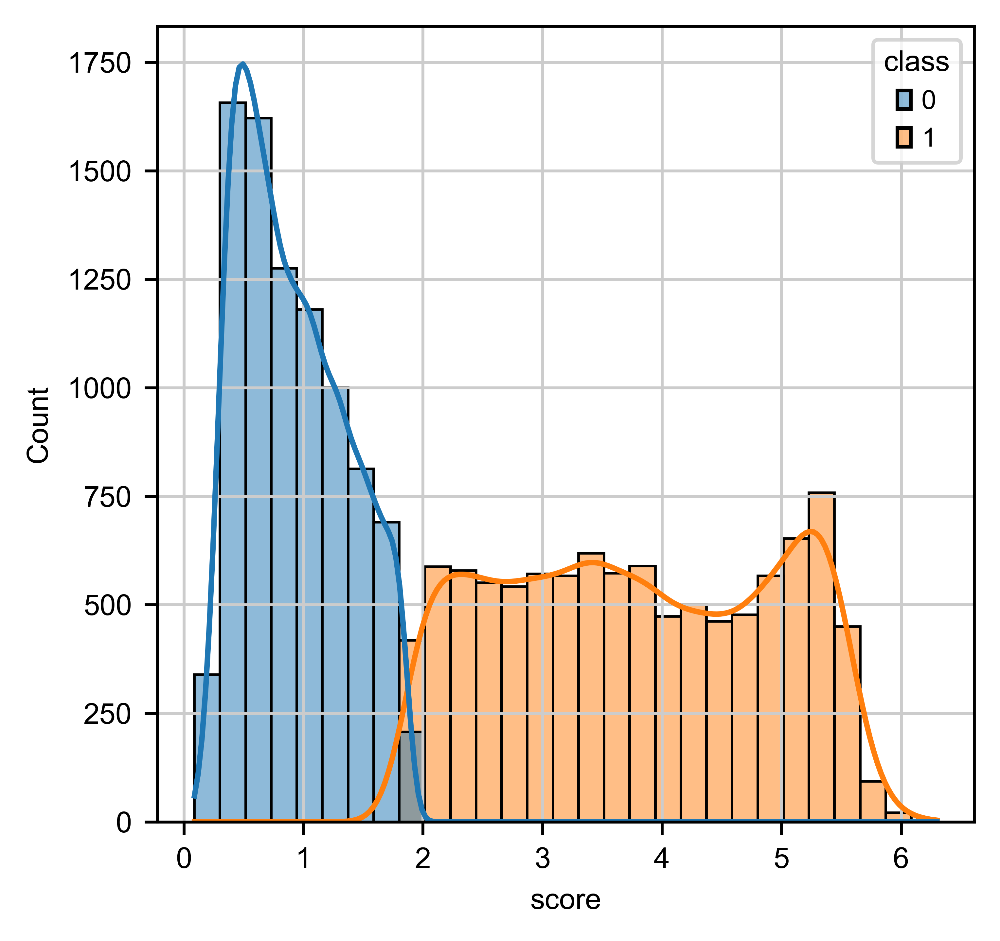

In [9]:
plt=sns.histplot(tmp, x = 'score', hue = 'class', palette = 'tab10', kde = True) #Plot results as histogram
fig = plt.get_figure()
fig.savefig('P_try_KRT6A_classification.eps')

# KRT6B

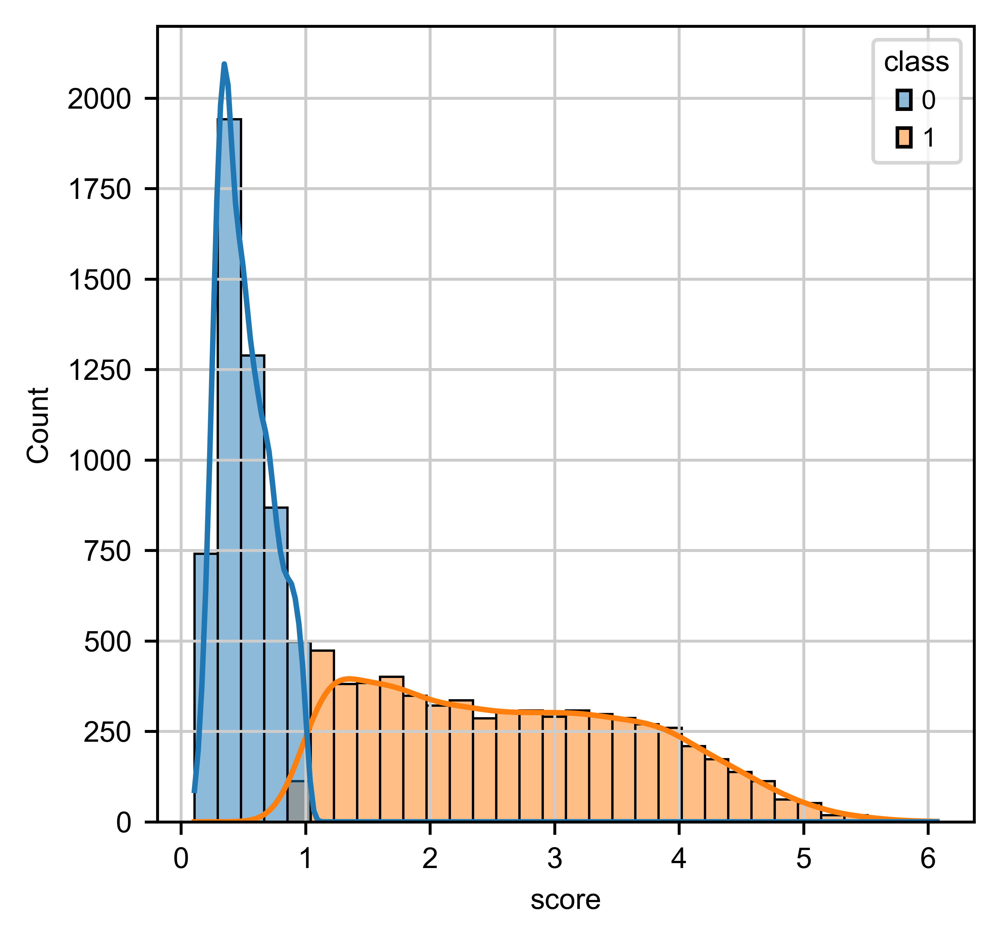

In [38]:
gene = 'KRT6B' # Which gene to use

x = adata.raw[:, gene].X.toarray() # Get raw expression matrix
pos_cells = adata.obs_names[x.flatten()>0] #Don't include cells with 0-epxression in the gaussian mixture classification (they interfere a bit with the results)
x = adata.raw[pos_cells][:, gene].X.toarray() #Get raw expression matrix again, but keep only positive cells

components = 2 #How many classes do we want
gmm = mixture.GaussianMixture(n_components=components, covariance_type='full').fit(x) #Initialize and fit gaussian mixture model based on expression levels

tmp = pd.DataFrame(x, columns = ['score'], index = pos_cells) #Temporary dataframe to keep expression and annotated classes
tmp['class'] = gmm.predict(x) #Predict cell class based on gene expression
sort = {x: ix for ix, (x, s) in enumerate(tmp.groupby('class')['score'].mean().sort_values().items())} #Sort the class so that the lowest class is always negative (normally it starts to number classes based on which class has most events)
tmp['class'] = [sort[x] for x in tmp['class']] #Do actual sorting

sns.histplot(tmp, x = 'score', hue = 'class', palette = 'tab10', kde = True) #Plot results as histogram

adata.obs['{}_class'.format(gene)] = ['{}-'.format(gene) if x not in tmp.index else '{} dim'.format(gene) if tmp.loc[x, 'class']==0 else '{}+'.format(gene) for x in adata.obs_names] 

# KRT6C

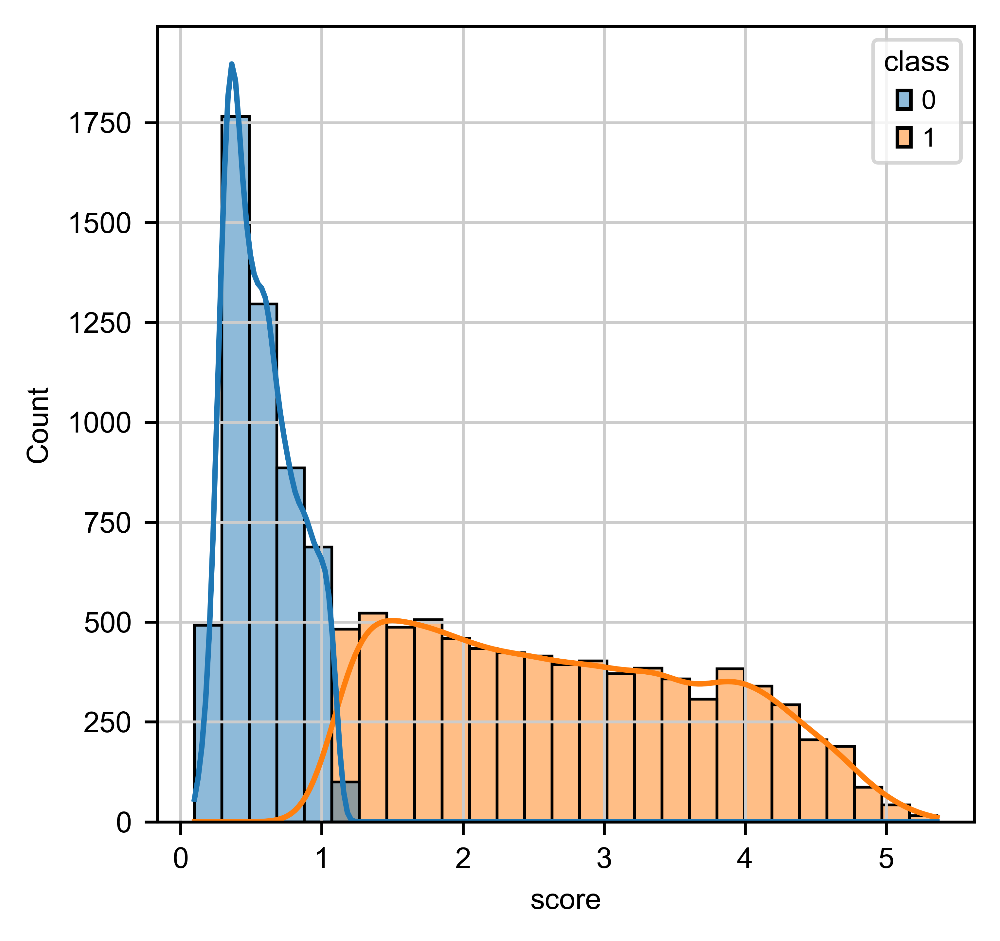

In [39]:
gene = 'KRT6C' # Which gene to use

x = adata.raw[:, gene].X.toarray() # Get raw expression matrix
pos_cells = adata.obs_names[x.flatten()>0] #Don't include cells with 0-epxression in the gaussian mixture classification (they interfere a bit with the results)
x = adata.raw[pos_cells][:, gene].X.toarray() #Get raw expression matrix again, but keep only positive cells

components = 2 #How many classes do we want
gmm = mixture.GaussianMixture(n_components=components, covariance_type='full').fit(x) #Initialize and fit gaussian mixture model based on expression levels

tmp = pd.DataFrame(x, columns = ['score'], index = pos_cells) #Temporary dataframe to keep expression and annotated classes
tmp['class'] = gmm.predict(x) #Predict cell class based on gene expression
sort = {x: ix for ix, (x, s) in enumerate(tmp.groupby('class')['score'].mean().sort_values().items())} #Sort the class so that the lowest class is always negative (normally it starts to number classes based on which class has most events)
tmp['class'] = [sort[x] for x in tmp['class']] #Do actual sorting

sns.histplot(tmp, x = 'score', hue = 'class', palette = 'tab10', kde = True) #Plot results as histogram

adata.obs['{}_class'.format(gene)] = ['{}-'.format(gene) if x not in tmp.index else '{} dim'.format(gene) if tmp.loc[x, 'class']==0 else '{}+'.format(gene) for x in adata.obs_names] 

# KRT16

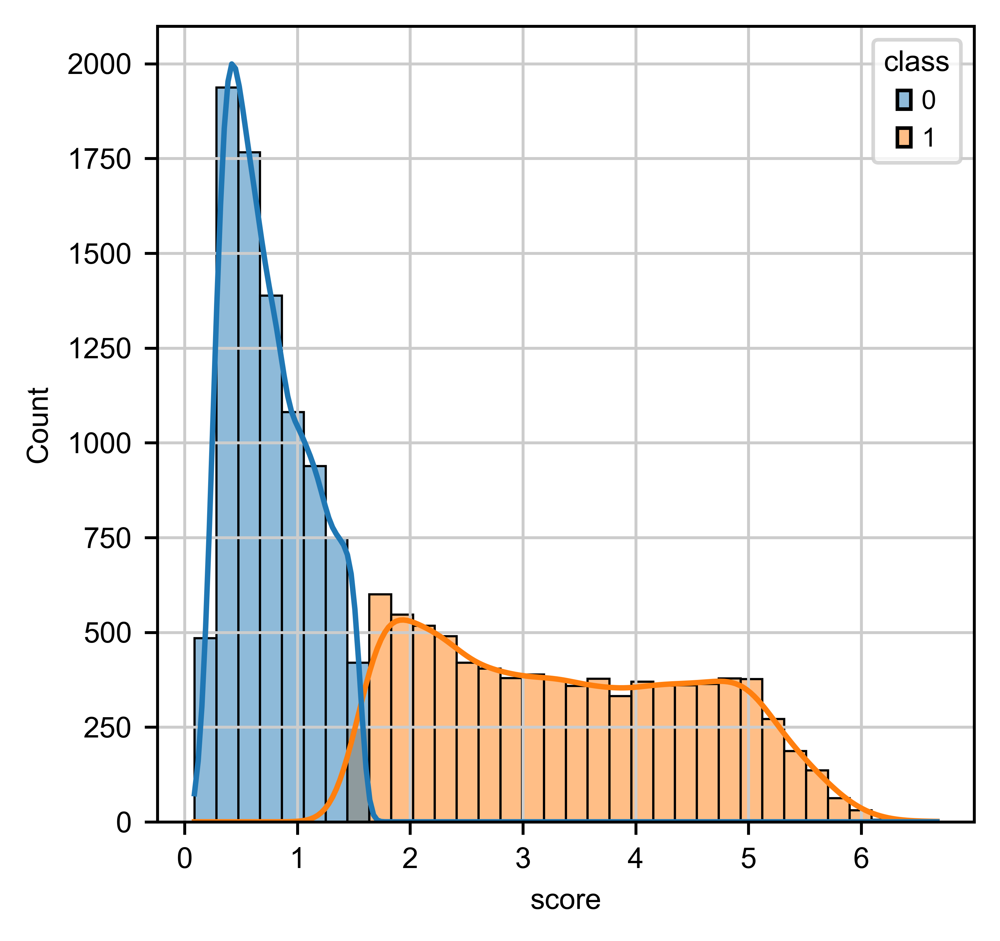

In [40]:
gene = 'KRT16' # Which gene to use

x = adata.raw[:, gene].X.toarray() # Get raw expression matrix
pos_cells = adata.obs_names[x.flatten()>0] #Don't include cells with 0-epxression in the gaussian mixture classification (they interfere a bit with the results)
x = adata.raw[pos_cells][:, gene].X.toarray() #Get raw expression matrix again, but keep only positive cells

components = 2 #How many classes do we want
gmm = mixture.GaussianMixture(n_components=components, covariance_type='full').fit(x) #Initialize and fit gaussian mixture model based on expression levels

tmp = pd.DataFrame(x, columns = ['score'], index = pos_cells) #Temporary dataframe to keep expression and annotated classes
tmp['class'] = gmm.predict(x) #Predict cell class based on gene expression
sort = {x: ix for ix, (x, s) in enumerate(tmp.groupby('class')['score'].mean().sort_values().items())} #Sort the class so that the lowest class is always negative (normally it starts to number classes based on which class has most events)
tmp['class'] = [sort[x] for x in tmp['class']] #Do actual sorting

sns.histplot(tmp, x = 'score', hue = 'class', palette = 'tab10', kde = True) #Plot results as histogram

adata.obs['{}_class'.format(gene)] = ['{}-'.format(gene) if x not in tmp.index else '{} dim'.format(gene) if tmp.loc[x, 'class']==0 else '{}+'.format(gene) for x in adata.obs_names] 

# KRT17

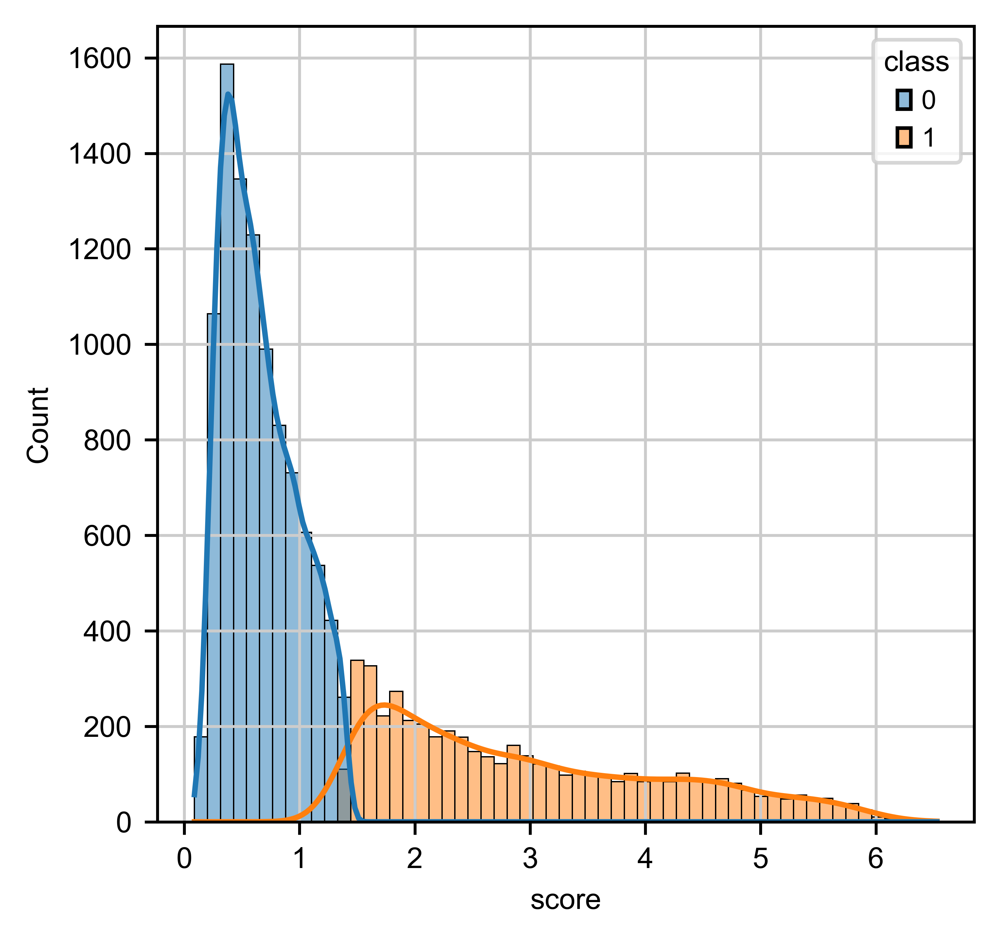

In [41]:
gene = 'KRT17' # Which gene to use

x = adata.raw[:, gene].X.toarray() # Get raw expression matrix
pos_cells = adata.obs_names[x.flatten()>0] #Don't include cells with 0-epxression in the gaussian mixture classification (they interfere a bit with the results)
x = adata.raw[pos_cells][:, gene].X.toarray() #Get raw expression matrix again, but keep only positive cells

components = 2 #How many classes do we want
gmm = mixture.GaussianMixture(n_components=components, covariance_type='full').fit(x) #Initialize and fit gaussian mixture model based on expression levels

tmp = pd.DataFrame(x, columns = ['score'], index = pos_cells) #Temporary dataframe to keep expression and annotated classes
tmp['class'] = gmm.predict(x) #Predict cell class based on gene expression
sort = {x: ix for ix, (x, s) in enumerate(tmp.groupby('class')['score'].mean().sort_values().items())} #Sort the class so that the lowest class is always negative (normally it starts to number classes based on which class has most events)
tmp['class'] = [sort[x] for x in tmp['class']] #Do actual sorting

sns.histplot(tmp, x = 'score', hue = 'class', palette = 'tab10', kde = True) #Plot results as histogram

adata.obs['{}_class'.format(gene)] = ['{}-'.format(gene) if x not in tmp.index else '{} dim'.format(gene) if tmp.loc[x, 'class']==0 else '{}+'.format(gene) for x in adata.obs_names] 

In [44]:
sc.pl.umap(adata, color = ['KRT6A_class','KRT6B_class', 'KRT6C_class', 
                           'KRT16_class', 'KRT17_class', 'CellTypes'], 
           frameon = False, ncols=3)

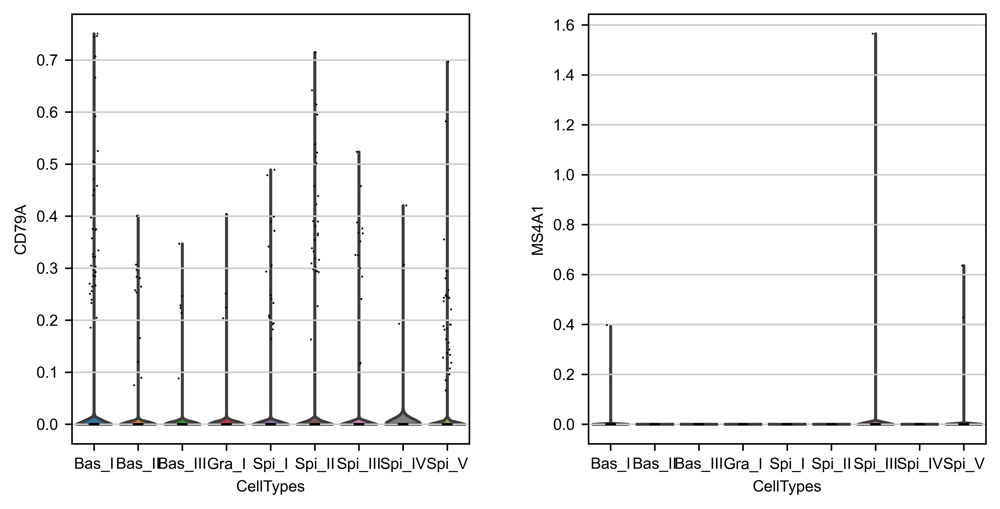

In [47]:
sc.pl.violin(adata, ['CD79A', 'MS4A1'], groupby='CellTypes' )

In [49]:
adata.obs.to_csv("p_try_KRT6A_wound_cells_metadata.csv")